In [1]:
#imports 
import os
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold, StratifiedKFold
from sklearn.metrics import mean_squared_error
import sklearn.datasets
from sklearn.metrics import accuracy_score, log_loss, roc_auc_score
from sklearn.model_selection import train_test_split
# import optuna 
import lightgbm as lgbm
# import xgboost as xgb

# Plots
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib_venn import venn2
from matplotlib import pyplot
import japanize_matplotlib
%matplotlib inline

# Others
from tqdm import tqdm
import time
from copy import deepcopy
pd.set_option('display.max_columns', 1000)
# sns.set(font="IPAexGothic")

In [2]:
INPUT_DIR = "../input"
OUTPUT_DIR = "../output"
REFE_DIR = "../reference"

In [3]:
product_master_df = pd.read_csv(os.path.join(INPUT_DIR, "product_master.csv"), dtype = {"JAN": str})
log_df = pd.read_csv(os.path.join(INPUT_DIR, "carlog.csv"),
                                    dtype = {"value_1": str},
                                    parse_dates = ["date"])
meta_df = pd.read_csv(os.path.join(INPUT_DIR, "meta.csv"))
test_df = pd.read_csv(os.path.join(INPUT_DIR, "test.csv"))

product_master_df.shape, log_df.shape, meta_df.shape, test_df.shape

((1965937, 14), (14632775, 18), (795936, 6), (56486, 1))

In [4]:
test_sessions = test_df["session_id"].unique()
len(test_df)

56486

## Utils

In [5]:
def savefig(fig, to):
    to = os.path.join(REFE_DIR, to + ".png")
    print(f"save to {to}")
    fig.tight_layout()
    fig.savefig(to, dpi=120) # dot per inch ： レゾリューション（解像度）

In [6]:
TARGET_CATEGORIES = [
    # お酒に関するもの
    'ビール系__RTD', 'ビール系__ビール系', 'ビール系__ノンアルコール',

    # お菓子に関するもの
    'スナック・キャンディー__スナック', 
    'チョコ・ビスクラ__チョコレート', 
    'スナック・キャンディー__ガム', 
    'スナック・キャンディー__シリアル',
    'アイスクリーム__ノベルティー', 
    '和菓子__米菓',

    # 飲料に関するもの
    '水・炭酸水__大型PET（炭酸水）',
    '水・炭酸水__小型PET（炭酸水）',
    '缶飲料__コーヒー（缶）',
    '小型PET__コーヒー（小型PET）',
    '大型PET__無糖茶（大型PET）',

    # 麺類
    '麺類__カップ麺',
]

In [7]:
product_master_df.head().T

,0,1,2,3,4
JAN,1,2,3,4,5
商品名,テナント商品1,テナント商品2,テナント商品3,テナント商品4,テナント商品5
部門CD,98,98,98,98,98
部門名,未登録等,未登録等,未登録等,未登録等,未登録等
カテゴリCD,99,99,99,99,99
カテゴリ名,未登録等その他,未登録等その他,未登録等その他,未登録等その他,未登録等その他
サブカテゴリCD,99,99,99,99,99
サブカテゴリ名,未登録等その他,未登録等その他,未登録等その他,未登録等その他,未登録等その他
セグメントCD,99,99,99,99,99
セグメント名,その他,その他,その他,その他,その他


In [8]:
# category_name ⇔ category_id の変換dictionary
cat2id = dict(zip(product_master_df["category_name"], product_master_df["category_id"]))
id2cat = dict(zip(product_master_df["category_id"], product_master_df["category_name"]))

In [9]:
for category in TARGET_CATEGORIES:
    print(f"{cat2id[category]}: {category}")

171: ビール系__RTD
173: ビール系__ビール系
172: ビール系__ノンアルコール
114: スナック・キャンディー__スナック
134: チョコ・ビスクラ__チョコレート
110: スナック・キャンディー__ガム
113: スナック・キャンディー__シリアル
38: アイスクリーム__ノベルティー
376: 和菓子__米菓
537: 水・炭酸水__大型PET（炭酸水）
539: 水・炭酸水__小型PET（炭酸水）
629: 缶飲料__コーヒー（缶）
467: 小型PET__コーヒー（小型PET）
435: 大型PET__無糖茶（大型PET）
768: 麺類__カップ麺


In [10]:
log_df.head(3).T

,0,1,2
session_id,0,0,0
register_number,2003,2003,2003
date,2019-02-14 00:00:00,2019-02-14 00:00:00,2019-02-14 00:00:00
hour,4,4,4
spend_time,0,32,37
display_action_id,136,209,209
user_id,bE94Gct4vGiKM7z2Y79cjk,bE94Gct4vGiKM7z2Y79cjk,bE94Gct4vGiKM7z2Y79cjk
value_1,NaN,4522646719765,4522646695663
name_1,NaN,おかかおにぎり ５９円,梅（種なし）おにぎり５９
kind_1,NaN,商品,商品


In [11]:
def only_purchase_records(input_df):
    idx = input_df["kind_1"] == "商品"
    out_df = input_df[idx].reset_index(drop=True)
    return out_df


def create_payment(input_df):
    """
    ログデータから sessin_id / JAN ごとの購買情報に変換する
    Args:
        input_df: レジカートログデータ

    Returns:
        session_id / JAN / n_items（合計購買数）のDataFrame
    """
    out_df = only_purchase_records(input_df)
    out_df = out_df.groupby(["session_id", "value_1"])["n_items"].sum().reset_index()
    out_df = out_df.rename(columns={"value_1": "JAN"})
    return out_df


def annot_category(input_df, master_df):
    """
    JAN（or value_1）にcategory_idを紐付ける
    """
    input_df = input_df.rename(columns={"value_1":"JAN"})
    out_df = pd.merge(input_df["JAN"],master_df[["JAN","category_id"]],on="JAN", how="left")
    return out_df["category_id"]


def only_payment_session_record(input_log_df):
    """
    支払いが紐づく（支払い完了flg=1）セッションにのみ絞り込む
    """
    payed_sessions = input_log_df[input_log_df["is_payment"] == 1]["session_id"].unique()
    idx = input_log_df["session_id"].isin(payed_sessions)
    out_df = input_log_df[idx].reset_index(drop=True)
    return out_df


def create_target_from_log(log_df, product_master_df, only_payment=True):
    """
    session_id と Target category_id ごとの購入合計数のクロス集計DataFrame
    """

    if only_payment:
        log_df = only_payment_session_record(log_df)
    pay_df = create_payment(log_df)
    pay_df["category_id"] = annot_category(pay_df, product_master_df)

    # category_idが紐付かないsessionは除外する
    idx_null = pay_df["category_id"].isnull()
    pay_df = pay_df[~idx_null].reset_index(drop=True)
    pay_df["category_id"] = pay_df["category_id"].astype(int)

    idx = pay_df["category_id"].isin([cat2id[i] for i in TARGET_CATEGORIES])
    target_df = pd.pivot_table(data=pay_df[idx],
                                index="session_id",
                                columns="category_id",
                                values="n_items",
                                aggfunc="sum")
    
    # target_categoryを購入していないsession_idも含める処理
    sessions = sorted(log_df["session_id"].unique())
    target_df = target_df.reindex(sessions)
    target_df = target_df.fillna(0).astype(int)

    return target_df, pay_df


In [12]:
# whole_log_df : test用sessionを除いたlogデータ
# payment_session_df : whole_log_deのなかで購入まで至っているセッション

# testのsession_idを除外
test_sessions = test_df["session_id"].unique()
idx_test = log_df["session_id"].isin(test_sessions)
whole_log_df = log_df[~idx_test].reset_index(drop=True)

# is_payment=1のsession_idのみに絞り込み
payment_session_df = only_payment_session_record(whole_log_df)

In [13]:
whole_log_df.groupby("session_id")["is_payment"].sum().value_counts()

1    618462
0     45246
Name: is_payment, dtype: int64

In [14]:
log_df.shape , whole_log_df.shape, log_df.shape[0] - whole_log_df.shape[0]

((14632775, 18), (14299716, 18), 333059)

## EDA（探索的データ分析）

買い物時間（spend_time）の分布はどうなっているか

Text(0.5, 1.0, 'セッションごとの最大買物時間')

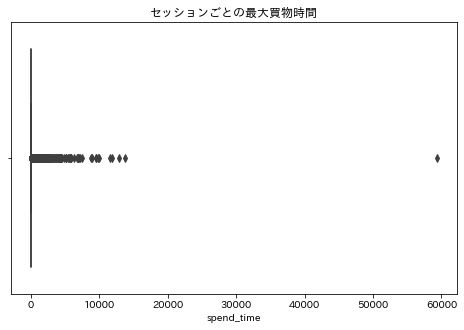

In [15]:
fig, ax = plt.subplots(figsize=(8,5))
sns.boxplot(data=whole_log_df.groupby("session_id")["spend_time"].max().reset_index()/60, x="spend_time" , ax=ax)
ax.set_title("セッションごとの最大買物時間")

In [16]:
 # 買い物時間が120分以上の客に絞り込み
_df = whole_log_df.groupby("session_id")["spend_time"].max().reset_index()
_df["spend_time"] = _df["spend_time"]/60
_df.query('spend_time > 120').sort_values("spend_time", ascending=False)

,session_id,spend_time
253001,253001,59327.366667
273004,273004,13745.166667
281961,281961,12809.350000
282841,282841,11806.516667
283215,283215,11506.083333
...,...,...
288516,288516,120.183333
301489,301489,120.150000
300863,300863,120.150000
287098,287098,120.100000


購入有無で、買い物時間に傾向差はあるか？

In [17]:
# 買い物時間120分以下にデータを絞り込み
x = pd.concat([whole_log_df.groupby("session_id")["spend_time"].max().rename("minutes")/60, whole_log_df.groupby("session_id")["is_payment"].sum()], axis=1)
idx = x["minutes"] < 120
print(f"over 2hour ratio: {((~idx).sum() / len(idx))*100:.2f}%")

over 2hour ratio: 0.19%


In [18]:
x = x[idx]

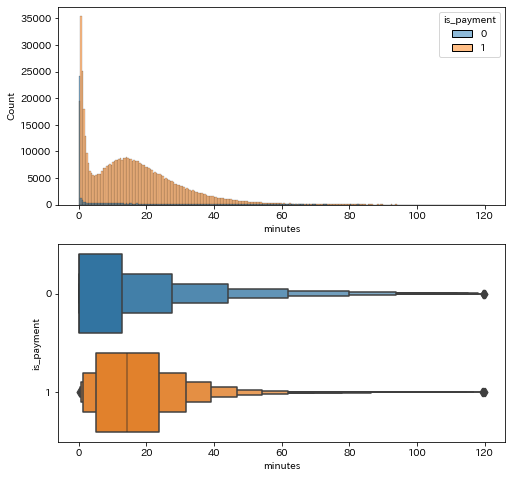

In [19]:
# sns.histplotは,seaborn==0.11.0から使用可
fig, axes = plt.subplots(figsize=(8,8), nrows=2)
sns.histplot(data=x, x="minutes", ax=axes[0], hue="is_payment")
sns.boxenplot(data=x, x="minutes", y="is_payment", orient="h", ax=axes[1])

### 買う時間と買う点数に関係性はあるか？
仮説：長い時間買い物している人は、たくさん買いそう

In [20]:
payment_session_df.head(3).T

,0,1,2
session_id,0,0,0
register_number,2003,2003,2003
date,2019-02-14 00:00:00,2019-02-14 00:00:00,2019-02-14 00:00:00
hour,4,4,4
spend_time,0,32,37
display_action_id,136,209,209
user_id,bE94Gct4vGiKM7z2Y79cjk,bE94Gct4vGiKM7z2Y79cjk,bE94Gct4vGiKM7z2Y79cjk
value_1,NaN,4522646719765,4522646695663
name_1,NaN,おかかおにぎり ５９円,梅（種なし）おにぎり５９
kind_1,NaN,商品,商品


In [21]:
# 購入発生ログに絞る
_df = pd.concat([payment_session_df.groupby("session_id")["n_items"].sum().rename("total_items"), payment_session_df.groupby("session_id")["spend_time"].max()/60], axis=1)

_df["spend_minutes_cat"] = pd.cut(_df["spend_time"], bins=np.linspace(0,40,20+1))

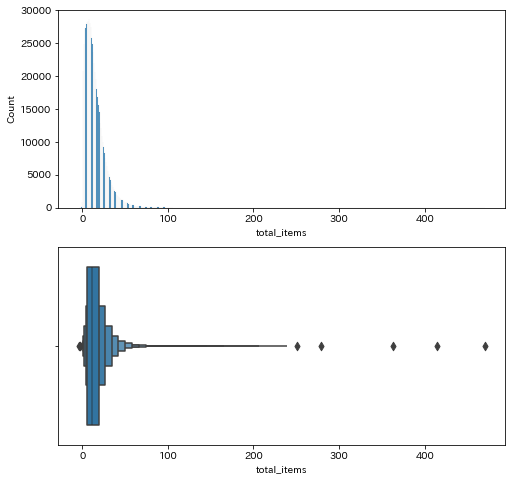

In [22]:
# この２パターン出力のやり方は頻出
fig, axes = plt.subplots(figsize=(8,8), nrows=2)
sns.histplot(data=_df, x="total_items",ax=axes[0])
sns.boxenplot(_df["total_items"],ax=axes[1], orient="h")

In [23]:
idx = _df["total_items"]>300
_df[idx].sample(3)

,total_items,spend_time,spend_minutes_cat
session_id,,,
419454,363,6.366667,"(6.0, 8.0]"
47099,415,155.083333,NaN
35279,470,82.883333,NaN


In [24]:
# 買い物時間が40分以下のsession_idに絞り込み
_df2 = _df.dropna()

_df3 = pd.pivot_table(data=_df2, index="total_items",
                    columns="spend_minutes_cat",
                    values="spend_time",
                    aggfunc="size").fillna(0)

2~4分だけ、傾向が違う
- 計画購買でサッサと買って帰っている客か？

4分〜は、時間の経過と共に買物点数も伸びていっている
- 非計画購買が起こっている可能性 

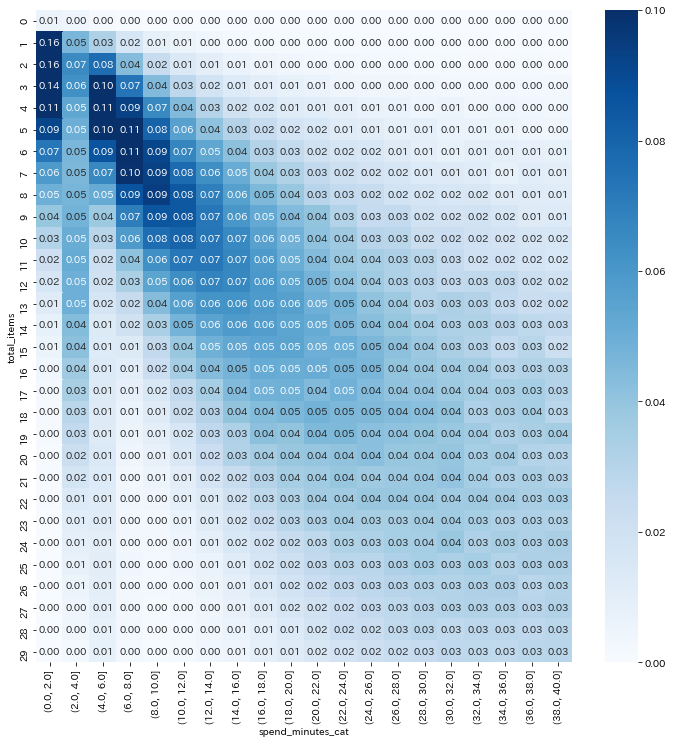

In [25]:
# 縦方向で足し合わせると100%となるように集計
# たとえば、買い物時間が0-2分の客は、total_itemsは何個である傾向が高いか？
x = _df3.div(_df3.sum(), axis=1)

# index(total_items)が0~29の範囲に絞る
x = x.reindex(range(30))

fig, ax = plt.subplots(figsize=(12,12))
sns.heatmap(x, ax=ax, cmap="Blues", vmax=.1, annot=True, fmt=".2f")

In [26]:
x

spend_minutes_cat,"(0.0, 2.0]","(2.0, 4.0]","(4.0, 6.0]","(6.0, 8.0]","(8.0, 10.0]","(10.0, 12.0]","(12.0, 14.0]","(14.0, 16.0]","(16.0, 18.0]","(18.0, 20.0]","(20.0, 22.0]","(22.0, 24.0]","(24.0, 26.0]","(26.0, 28.0]","(28.0, 30.0]","(30.0, 32.0]","(32.0, 34.0]","(34.0, 36.0]","(36.0, 38.0]","(38.0, 40.0]"
total_items,,,,,,,,,,,,,,,,,,,,
0,0.005903,0.004684,0.001253,0.000528,0.000267,0.000162,0.000230,0.000130,0.000055,0.000119,0.000067,0.000038,0.000043,0.000000,0.000000,0.000068,0.000000,0.000000,0.000000,0.000000
1,0.159762,0.046286,0.032418,0.016639,0.008968,0.006065,0.003888,0.002599,0.001842,0.001729,0.001770,0.001169,0.000730,0.000694,0.001048,0.000752,0.000647,0.000287,0.000564,0.000281
2,0.159342,0.065219,0.076317,0.043550,0.023934,0.014404,0.010461,0.007017,0.005306,0.003696,0.003441,0.003092,0.002147,0.002230,0.001922,0.001846,0.001374,0.001433,0.001918,0.000561
3,0.143181,0.062765,0.102308,0.073486,0.044750,0.027861,0.019106,0.012995,0.010502,0.008047,0.006815,0.004676,0.004896,0.004658,0.004019,0.003076,0.002910,0.003154,0.002708,0.002948
4,0.112787,0.053731,0.113545,0.093151,0.065744,0.044593,0.030181,0.020246,0.016578,0.012071,0.011057,0.009012,0.007258,0.006392,0.004543,0.005947,0.004122,0.004969,0.003836,0.003229
5,0.091458,0.049743,0.101257,0.110740,0.080087,0.055640,0.041025,0.030850,0.023836,0.017913,0.015767,0.011991,0.010737,0.008869,0.009028,0.006767,0.006627,0.006212,0.004626,0.004632
6,0.072421,0.046398,0.086544,0.109403,0.091460,0.067336,0.053634,0.041921,0.030571,0.025692,0.020210,0.017232,0.015804,0.012536,0.010193,0.008134,0.010022,0.009557,0.008236,0.007861
7,0.058867,0.046035,0.066575,0.099377,0.093598,0.077354,0.063584,0.050888,0.038407,0.031653,0.026122,0.021305,0.018553,0.016103,0.012931,0.012782,0.011557,0.008123,0.010944,0.010247
8,0.049354,0.046927,0.051457,0.086643,0.094400,0.084746,0.069569,0.056423,0.045225,0.038926,0.029864,0.025679,0.024050,0.018878,0.017008,0.015995,0.015518,0.012424,0.012298,0.011510


### 上記は、カテゴリごとに起こりやすさに違いがあるのか

In [27]:
payment_session_df.head(3).T

,0,1,2
session_id,0,0,0
register_number,2003,2003,2003
date,2019-02-14 00:00:00,2019-02-14 00:00:00,2019-02-14 00:00:00
hour,4,4,4
spend_time,0,32,37
display_action_id,136,209,209
user_id,bE94Gct4vGiKM7z2Y79cjk,bE94Gct4vGiKM7z2Y79cjk,bE94Gct4vGiKM7z2Y79cjk
value_1,NaN,4522646719765,4522646695663
name_1,NaN,おかかおにぎり ５９円,梅（種なし）おにぎり５９
kind_1,NaN,商品,商品


In [28]:
product_master_df.head(1)

,JAN,商品名,部門CD,部門名,カテゴリCD,カテゴリ名,サブカテゴリCD,サブカテゴリ名,セグメントCD,セグメント名,サブセグメントCD,サブセグメント名,category_name,category_id
0,1,テナント商品1,98,未登録等,99,未登録等その他,99,未登録等その他,99,その他,99,その他,未登録等__未登録等その他,517


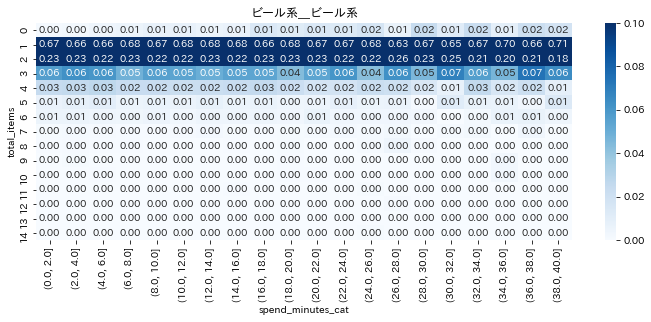

In [26]:
target_name = "ビール系__ビール系"
target_id = cat2id[target_name]
jans = product_master_df[product_master_df["category_id"]==target_id]["JAN"].unique().astype(str)

idx = payment_session_df["value_1"].isin(jans)

_df = pd.concat([payment_session_df[idx].groupby("session_id")["n_items"].sum().rename("total_items"), payment_session_df[idx].groupby("session_id")["spend_time"].max()/60], axis=1)

_df["spend_minutes_cat"] = pd.cut(_df["spend_time"], bins=np.linspace(0,40,20+1))

# 買い物時間が40分以下のsession_idに絞り込み
_df2 = _df.dropna()
_df3 = pd.pivot_table(data=_df2, index="total_items",
                    columns="spend_minutes_cat",
                    values="spend_time",
                    aggfunc="size").fillna(0)

x = _df3.div(_df3.sum(), axis=1)
x = x.reindex(range(15))
fig, ax = plt.subplots(figsize=(12,4))
ax.set_title(target_name)
sns.heatmap(x, ax=ax, cmap="Blues", vmax=.1, annot=True, fmt=".2f")

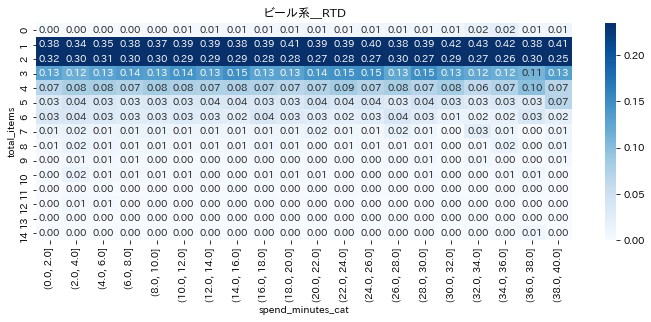

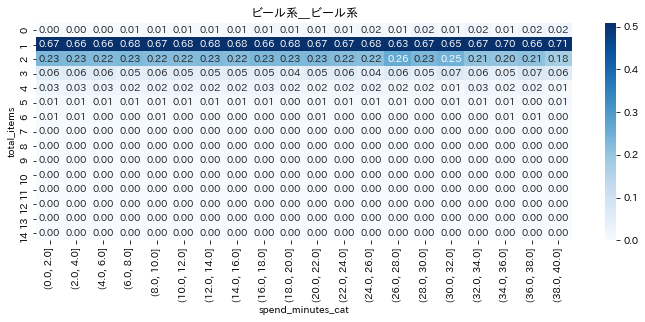

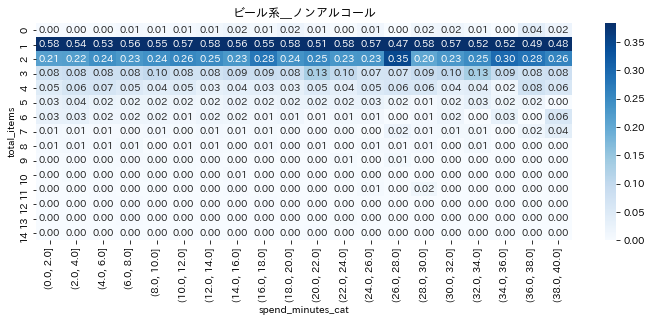

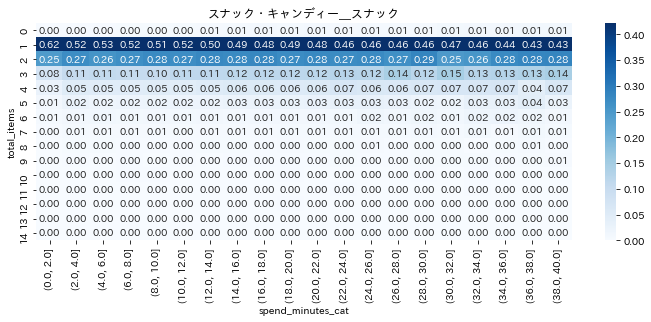

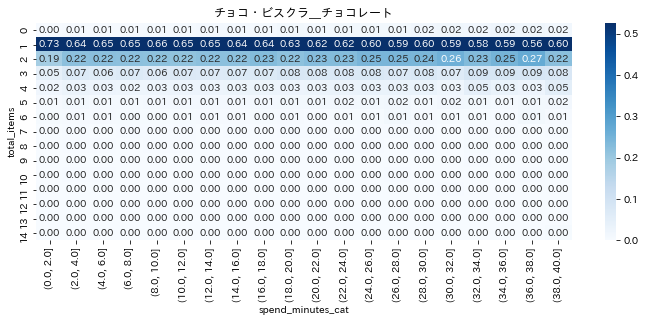

...

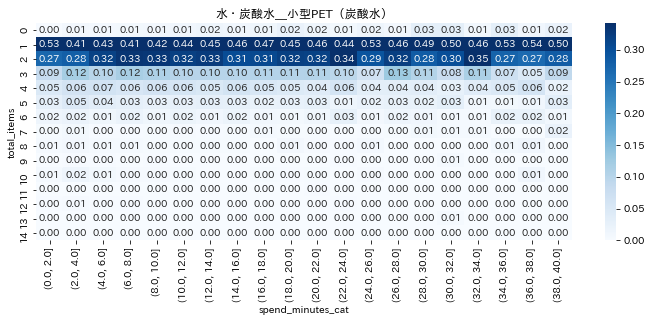

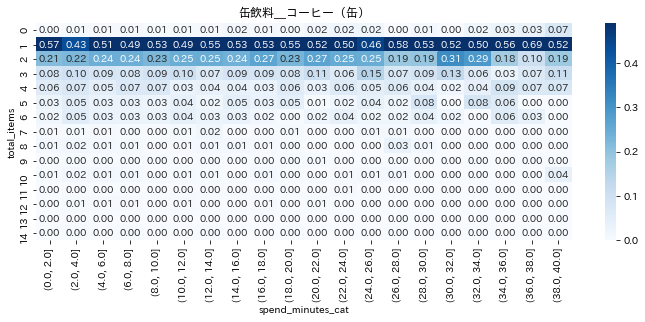

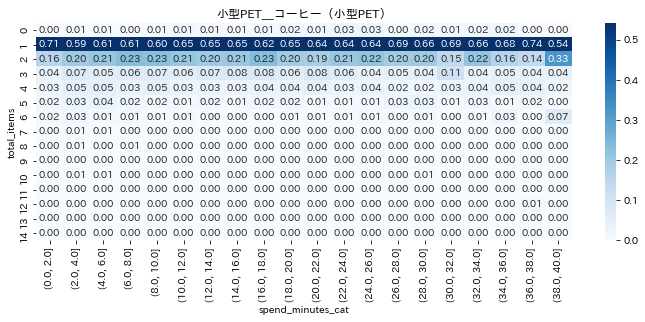

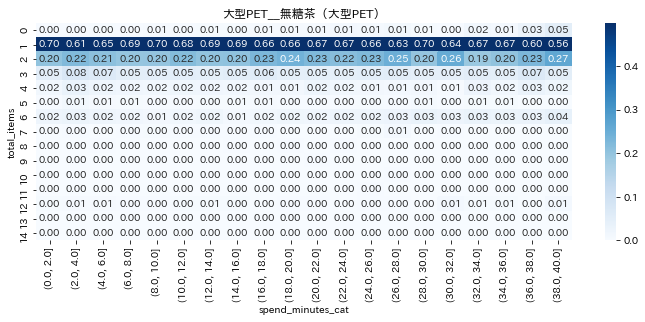

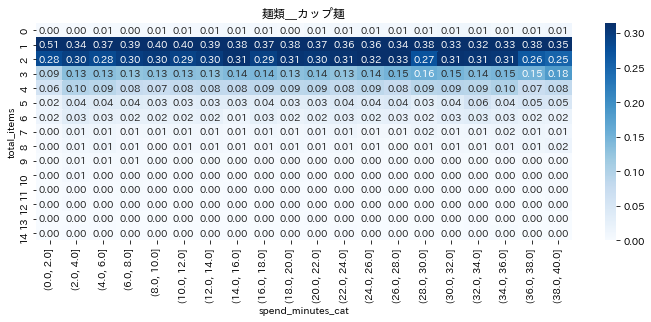

In [97]:
for target_name in TARGET_CATEGORIES:
    target_id = cat2id[target_name]
    jans = product_master_df[product_master_df["category_id"]==target_id]["JAN"].unique().astype(str)

    idx = payment_session_df["value_1"].isin(jans)

    _df = pd.concat([payment_session_df[idx].groupby("session_id")["n_items"].sum().rename("total_items"), payment_session_df[idx].groupby("session_id")["spend_time"].max()/60], axis=1)

    _df["spend_minutes_cat"] = pd.cut(_df["spend_time"], bins=np.linspace(0,40,20+1))

    # 買い物時間が40分以下のsession_idに絞り込み
    _df2 = _df.dropna()
    _df3 = pd.pivot_table(data=_df2, index="total_items",
                        columns="spend_minutes_cat",
                        values="spend_time",
                        aggfunc="size").fillna(0)

    x = _df3.div(_df3.sum(), axis=1)
    x = x.reindex(range(15))
    vmax = x.max().max()-0.2
    fig, ax = plt.subplots(figsize=(12,4))
    ax.set_title(target_name)
    sns.heatmap(x, ax=ax, cmap="Blues", vmax=vmax, annot=True, fmt=".2f")

### 時間帯とアクションの関係性はあるか

In [27]:
display_action_df = pd.read_csv(os.path.join(INPUT_DIR,"display_action_id.csv"))

In [28]:
payment_session_df.head(1)

,session_id,register_number,date,hour,spend_time,display_action_id,user_id,value_1,name_1,kind_1,number_1,value_2,name_2,kind_2,number_2,unit_price,n_items,is_payment
0,0,2003,2019-02-14,4,0,136,bE94Gct4vGiKM7z2Y79cjk,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0


In [29]:
display_action_df.head(1)

,display_action_id,論理名,display_name,action_name
0,8,クーポン,クーポンPOP,クーポン発券


In [30]:
display_action_names = display_action_df["display_name"]+"_"+display_action_df["action_name"]
display_id2name = dict(zip(display_action_df["display_action_id"], display_action_names))

In [31]:
_df = pd.pivot_table(data=payment_session_df,
                    index="hour",
                    columns=payment_session_df["display_action_id"].map(display_id2name),
                    values="session_id",
                    aggfunc="size").fillna(0)

In [32]:
# actionごとで割合を出す
_df = _df.div(_df.sum(), axis=1)

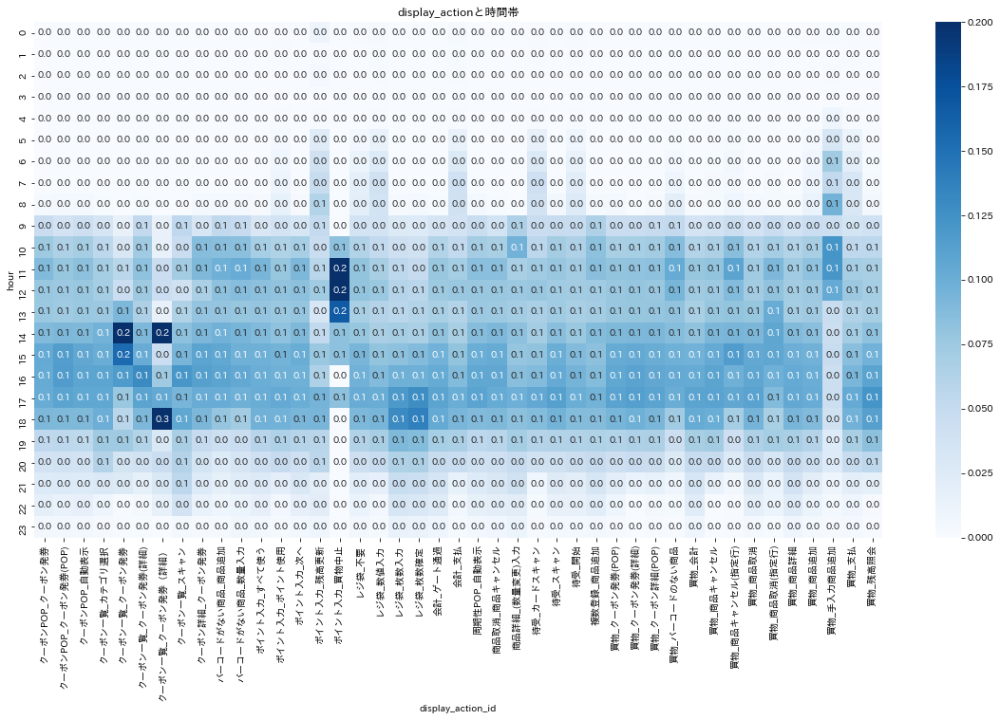

In [33]:
fig, ax = plt.subplots(figsize=(20,10))
ax.set_title("display_actionと時間帯")
sns.heatmap(_df, ax=ax,vmax=.2,  cmap="Blues", annot=True, fmt=".1f")

In [34]:
# savefig(fig,"display_actionと時間帯")

# 学習の枠組みづくり

In [35]:
meta_df.head()

,session_id,user_id,date,hour,register_number,time_elapsed
0,0,bE94Gct4vGiKM7z2Y79cjk,2019-02-14,4,2003,NaN
1,1,V4bEuaKPEPoK8MswqPksvK,2019-02-14,4,2006,NaN
2,2,ntRurFKVWYBQR86auef5Fc,2019-02-14,5,2001,NaN
3,3,GhHaHMCyrz76y2dCeVXfbn,2019-02-14,5,2001,NaN
4,4,kG58HejrEcbjJQ7JojRSay,2019-02-14,5,2002,NaN


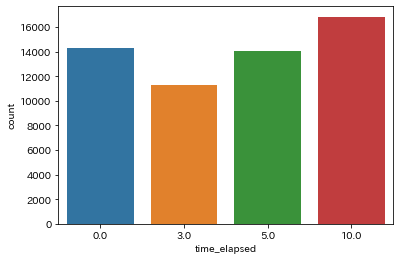

In [36]:
sns.countplot(meta_df["time_elapsed"])

### 購入時間が10分より長いユーザーに絞り込む
- testデータのつくりが、購入時間が10分より長いユーザーからランダムで「0,3,5,10」分で切っているため
- payment_session_dfから絞り込む
- train_whole_log_df と命名

In [37]:
payment_session_df.head(3)

,session_id,register_number,date,hour,spend_time,display_action_id,user_id,value_1,name_1,kind_1,number_1,value_2,name_2,kind_2,number_2,unit_price,n_items,is_payment
0,0,2003,2019-02-14,4,0,136,bE94Gct4vGiKM7z2Y79cjk,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0
1,0,2003,2019-02-14,4,32,209,bE94Gct4vGiKM7z2Y79cjk,4522646719765,おかかおにぎり ５９円,商品,1.0,NaN,NaN,NaN,NaN,59.0,1,0
2,0,2003,2019-02-14,4,37,209,bE94Gct4vGiKM7z2Y79cjk,4522646695663,梅（種なし）おにぎり５９,商品,1.0,NaN,NaN,NaN,NaN,59.0,1,0


In [38]:
is_item_record = payment_session_df["kind_1"]=="商品"
max_payed_time = payment_session_df[is_item_record].groupby("session_id")["spend_time"].max()
max_payed_time_over_10minutes = max_payed_time[max_payed_time/60 >10]

# こうやって対象のIDを作成している（indexでいける）
train_sessions = max_payed_time_over_10minutes.index.unique()

idx = payment_session_df["session_id"].isin(train_sessions)
train_whole_log_df = payment_session_df[idx].reset_index(drop=True)

In [39]:
train_whole_log_df.shape

(10415230, 18)

In [40]:
train_whole_log_df.head(3).T

,0,1,2
session_id,105,105,105
register_number,1005,1005,1005
date,2019-02-14 00:00:00,2019-02-14 00:00:00,2019-02-14 00:00:00
hour,9,9,9
spend_time,0,50,96
display_action_id,136,209,209
user_id,CN9sWHXp6RdCuyFkW5aemG,CN9sWHXp6RdCuyFkW5aemG,CN9sWHXp6RdCuyFkW5aemG
value_1,NaN,4901670110210,4522646718089
name_1,NaN,サランラップ３０ｃｍ＊２,食品用ラップ ２０m
kind_1,NaN,商品,商品


出現頻度と同確率で0,3,5,10の乱数を持ったカラムを作成し、trainを擬似的にpublic/privateに分割

In [41]:
time_elapsed_count = meta_df["time_elapsed"].value_counts(normalize=True)
train_time_elapsed = np.random.choice(time_elapsed_count.index.astype(int),
                                    p = time_elapsed_count.values,
                                    size = len(train_sessions))

In [42]:
train_meta_df = pd.DataFrame({
    "session_id": train_sessions,
    "time_elapsed": train_time_elapsed
})

train_meta_df = pd.merge(train_meta_df,meta_df.drop("time_elapsed", axis=1),
                        on="session_id", how="left")

# train_meta_df と test_meta_df は同じ形式（見ることができる time_elapsed がある）
test_meta_df = pd.merge(test_df,meta_df,on="session_id", how="left")

In [43]:
train_meta_df

,session_id,time_elapsed,user_id,date,hour,register_number
0,105,0,CN9sWHXp6RdCuyFkW5aemG,2019-02-14,9,1005
1,106,0,Wi5hmLRCmUPXMRheu354dd,2019-02-14,9,1010
2,107,10,kTFrFDLeaaggCoubWZJHpg,2019-02-14,9,1010
3,108,10,exwdBc8tNJYAjhc4Gd6qtj,2019-02-14,9,1011
4,109,0,XUeiScqGsozKQFxcd3RDsD,2019-02-14,9,1013
...,...,...,...,...,...,...
366473,663695,3,9PqM4MJE3qW5JUnkHFdh8m,2020-07-31,23,1018
366474,663697,5,MpvTW7dBYFRPbtJwRF2ooh,2020-07-31,23,1028
366475,663698,3,V99jbzBhSuUm8NBkzEem7a,2020-07-31,23,1058
366476,663699,0,mtMFzeYSyhQUPYUvKtApZQ,2020-07-31,23,1076


idx_show：spend_timeがpublic側に属していればTrue

In [44]:
_df = pd.merge(train_whole_log_df[["session_id","spend_time"]], train_meta_df, on="session_id", how="left")
idx_show = _df["spend_time"] <= _df["time_elapsed"]*60

In [45]:
print(f"public側のlog割合：{idx_show.sum()/len(idx_show)}")

public側のlog割合：0.23164106793608974


train_logを擬似的に見えるデータ（public）と見えないデータ（private）に分割した

In [46]:
train_public_df = train_whole_log_df[idx_show].reset_index(drop=True)
train_private_df = train_whole_log_df[~idx_show].reset_index(drop=True)

In [47]:
train_public_df.shape, train_private_df.shape

((2412595, 18), (8002635, 18))

In [48]:
train_public_df.head(3).T

,0,1,2
session_id,105,106,107
register_number,1005,1010,1010
date,2019-02-14 00:00:00,2019-02-14 00:00:00,2019-02-14 00:00:00
hour,9,9,9
spend_time,0,0,0
display_action_id,136,136,136
user_id,CN9sWHXp6RdCuyFkW5aemG,Wi5hmLRCmUPXMRheu354dd,kTFrFDLeaaggCoubWZJHpg
value_1,NaN,NaN,NaN
name_1,NaN,NaN,NaN
kind_1,NaN,NaN,NaN


In [49]:
# testのログデータと合わせて、推論時に見ても良いログ”public_log_df”として保存しておく
# どこで使うのか、まだ良くわかっていない・・
public_log_df = pd.concat([train_public_df, log_df[log_df["session_id"].isin(test_sessions)]], axis=0, ignore_index=True)

In [50]:
public_log_df.shape

(2745654, 18)

これで、testと同じ状況（見ていい範囲を擬似的につくった）のtrainデータができて、学習の枠組みが整った　　
- train全体のなかで、見ていい範囲と見れない範囲を区切った

## つくったtrainデータ VS testデータ の比較

In [51]:
# train/testでの各カラムごとの重複度合いをベン図で可視化

def plot_venn2(left, right, column, set_labels, ax=None):
    left_set = set(left[column])
    right_set = set(right[column])
    venn2(subsets=[left_set,right_set], set_labels=set_labels, ax=ax)
    return ax

def right_left_insersection(train_df, test_df, columns="__all__"):
    """
    ２つのデータうレームのカラムの共通集合を可視化
    """
    if columns == "__all__":
        columns = set(train_df.columns) & set(test_df.columns)

    columns = list(columns)
    nfigs = len(columns)
    ncols = 4  # Notebookの使える幅によって調整
    nrows = - (- nfigs//ncols) # 切り上げ処理
    fig, axes = plt.subplots(figsize=(3*ncols, 2*nrows), ncols=ncols, nrows=nrows)
    axes = np.ravel(axes) # １次元にして、うまくfor文でplotできるように
    for column, ax in zip(columns, axes):
        plot_venn2(train_df,test_df, column=column, set_labels=["Train","Test"], ax=ax)
        ax.set_title(column)
    return fig, ax

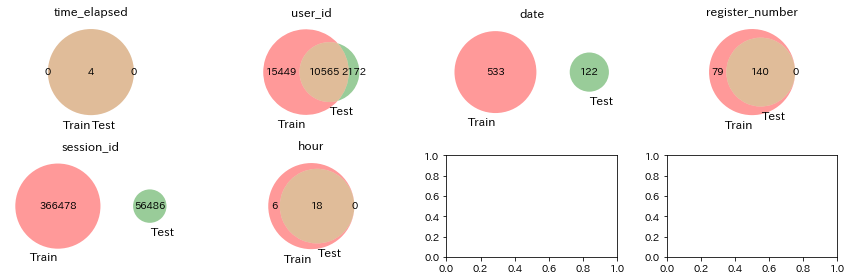

In [52]:
fig, _ = right_left_insersection(train_meta_df,test_meta_df)
fig.tight_layout()

In [53]:
train_target_df, _ = create_target_from_log(train_private_df, product_master_df=product_master_df, only_payment=False)

In [54]:
train_target_df.shape

(366478, 15)

In [55]:
train_target_df

category_id,38,110,113,114,134,171,172,173,376,435,467,537,539,629,768
session_id,,,,,,,,,,,,,,,
105,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0
106,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
107,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
108,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
109,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
663695,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
663697,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
663698,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0


# 特徴量作成の方針
1. そのセッションがいつどこで起こったか
    - 時間帯と時間帯に紐づくログの特徴（時間帯ごとのアクション分布）：`HourActionPortfolioBlock`
    - 日付（曜日・日・年）：`DateBlock`
    - レジカートの番号：`MetaInformationBlock`
    
1. ユーザーがどういう人か
    - 性別・年齢
    - 過去どのような部門の商品を購入しているか：`UserHistoryBlock`

1. 見えている範囲のログでどういうイベントが発生しているか
     - すでに何個商品を買ったか・買った商品の多様性：`PublicLogBlock`
     

### classやdefの作り方
input_df でinputし、out_df がreturnされる仕組み

In [56]:
train_meta_df.head()

,session_id,time_elapsed,user_id,date,hour,register_number
0,105,0,CN9sWHXp6RdCuyFkW5aemG,2019-02-14,9,1005
1,106,0,Wi5hmLRCmUPXMRheu354dd,2019-02-14,9,1010
2,107,10,kTFrFDLeaaggCoubWZJHpg,2019-02-14,9,1010
3,108,10,exwdBc8tNJYAjhc4Gd6qtj,2019-02-14,9,1011
4,109,0,XUeiScqGsozKQFxcd3RDsD,2019-02-14,9,1013


In [57]:
class AbstractBaseBlock:
    def fit(self, input_df, y=None):
        return self.transform(input_df)
    
    def transform(self, input_df):
        raise NotImplementedError()

In [58]:
class MetaInformationBlock(AbstractBaseBlock):
    def transform(self, input_df):
        use_columns = [ 'hour', 'register_number', 'time_elapsed']
        return input_df[use_columns].copy()

In [59]:
MetaInformationBlock().fit(train_meta_df)

,hour,register_number,time_elapsed
0,9,1005,0
1,9,1010,0
2,9,1010,10
3,9,1011,10
4,9,1013,0
...,...,...,...
366473,23,1018,3
366474,23,1028,5
366475,23,1058,3
366476,23,1076,0


In [60]:
class DateBlock(AbstractBaseBlock):
    def transform(self, input_df):
        date = pd.to_datetime(input_df["date"])

        out_df = pd.DataFrame({
            "dayofweek":date.dt.dayofweek,
            "day":date.dt.day,
            "year":date.dt.year,
        })

        #金曜の夜はお祭り騒ぎ
        out_df["hanakin"] = np.where((date.dt.dayofweek==4) & (input_df["hour"]>17), 1, 0)

        return out_df.add_prefix("date_")

In [61]:
block = DateBlock()
tr_out_df = block.fit(train_meta_df)
tes_out_df = block.transform(test_meta_df)

In [62]:
assert len(train_meta_df) == len(tr_out_df)
assert len(tr_out_df.T) == len(tes_out_df.T)

CountEncodingは、fitしてtransformで適用する.  
なぜなら、train側のcount数をtest側でも使用するため.  
CountEncodingする対象は、たとえば以下
- hour
- register_number

In [63]:
class CountEncodingBlock(AbstractBaseBlock):
    """
    CountEncodingを行う block
    インスタンス生成時の引数に、CountEncodingしたいカラム名を入れる
    """

    # これ、なに？
    def __init__(self, column: str):
        self.column = column

    def fit(self, input_df, y=None):
        vc = input_df[self.column].value_counts()

        # なぜ、わざわざ持ち直した？（self.~ でないとtransformに引き継げない？）
        self.count_ = vc  
        return self.transform(input_df)

    def transform(self, input_df):
        out_df = pd.DataFrame()
        out_df[self.column] = input_df[self.column].map(self.count_)
        return out_df.add_prefix("CE_")

In [64]:
# Count数が同じものは同一ラベルになる
# だから、左右で数値が食い違う場合が生じている
CountEncodingBlock("register_number").fit(train_meta_df)["CE_register_number"].value_counts()

2294    6882
2291    4582
2130    4260
1860    3720
1752    3504
        ... 
22        22
20        20
7          7
5          5
1          1
Name: CE_register_number, Length: 211, dtype: int64

In [65]:
class HourActionPortfolioBlock(AbstractBaseBlock):
    """
    時間ごとの `display_action_id` の出現回数を紐付けるblock
    """

    def fit(self, input_df, y=None):
        
        # input_df と紐づけるための外部テーブル(_df)を作成
        # pd.mergeで紐付ける 
        _df = pd.pivot_table(
            data=whole_log_df,  # class内でinput_df 以外のデータも使用可！
            index="hour",
            columns=whole_log_df["display_action_id"].map(display_id2name),
            values="session_id",
            aggfunc="count"
        ).fillna(0)

        self.pivot_df_ = _df  # クラス自身（self）内にて保持
        return self.transform(input_df)


    def transform(self, input_df):
        out_df = pd.merge(input_df["hour"],
                            self.pivot_df_,
                            on="hour", how="left").drop(columns=["hour"])
        return out_df.add_prefix("hour_ratio=")


In [66]:
HourActionPortfolioBlock().fit(train_meta_df)

,hour_ratio=クーポンPOP_クーポン発券,hour_ratio=クーポンPOP_クーポン発券(POP),hour_ratio=クーポンPOP_自動表示,hour_ratio=クーポン一覧_カテゴリ選択,hour_ratio=クーポン一覧_クーポン発券,hour_ratio=クーポン一覧_クーポン発券(詳細),hour_ratio=クーポン一覧_クーポン発券（詳細）,hour_ratio=クーポン一覧_スキャン,hour_ratio=クーポン詳細_クーポン発券,hour_ratio=バーコードがない商品_商品追加,hour_ratio=バーコードがない商品_数量入力,hour_ratio=ポイント入力_すべて使う,hour_ratio=ポイント入力_ポイント使用,hour_ratio=ポイント入力_次へ,hour_ratio=ポイント入力_残高更新,hour_ratio=ポイント入力_買物中止,hour_ratio=レジ袋_不要,hour_ratio=レジ袋_数値入力,hour_ratio=レジ袋_枚数入力,hour_ratio=レジ袋_枚数確定,hour_ratio=会計_ゲート通過,hour_ratio=会計_支払,hour_ratio=周期性POP_自動表示,hour_ratio=商品取消_商品キャンセル,hour_ratio=商品詳細_(数量変更)入力,hour_ratio=待受_カードスキャン,hour_ratio=待受_スキャン,hour_ratio=待受_開始,hour_ratio=複数登録_商品追加,hour_ratio=買物_クーポン発券(POP),hour_ratio=買物_クーポン発券(詳細),hour_ratio=買物_クーポン詳細(POP),hour_ratio=買物_バーコードのない商品,hour_ratio=買物_会計,hour_ratio=買物_商品キャンセル,hour_ratio=買物_商品キャンセル(指定行),hour_ratio=買物_商品取消,hour_ratio=買物_商品取消(指定行),hour_ratio=買物_商品詳細,hour_ratio=買物_商品追加,hour_ratio=買物_手入力商品追加,hour_ratio=買物_支払,hour_ratio=買物_残高照会
0,4470.0,1801.0,13014.0,7121.0,432.0,101.0,1.0,48.0,87.0,2897.0,1811.0,584.0,1683.0,782.0,47.0,0.0,19625.0,10547.0,1572.0,698.0,10618.0,11560.0,4582.0,4507.0,514.0,5417.0,6353.0,18961.0,1375.0,9185.0,8551.0,7616.0,8905.0,8826.0,4293.0,74.0,1988.0,34.0,2905.0,418692.0,392.0,15688.0,6023.0
1,4470.0,1801.0,13014.0,7121.0,432.0,101.0,1.0,48.0,87.0,2897.0,1811.0,584.0,1683.0,782.0,47.0,0.0,19625.0,10547.0,1572.0,698.0,10618.0,11560.0,4582.0,4507.0,514.0,5417.0,6353.0,18961.0,1375.0,9185.0,8551.0,7616.0,8905.0,8826.0,4293.0,74.0,1988.0,34.0,2905.0,418692.0,392.0,15688.0,6023.0
2,4470.0,1801.0,13014.0,7121.0,432.0,101.0,1.0,48.0,87.0,2897.0,1811.0,584.0,1683.0,782.0,47.0,0.0,19625.0,10547.0,1572.0,698.0,10618.0,11560.0,4582.0,4507.0,514.0,5417.0,6353.0,18961.0,1375.0,9185.0,8551.0,7616.0,8905.0,8826.0,4293.0,74.0,1988.0,34.0,2905.0,418692.0,392.0,15688.0,6023.0
3,4470.0,1801.0,13014.0,7121.0,432.0,101.0,1.0,48.0,87.0,2897.0,1811.0,584.0,1683.0,782.0,47.0,0.0,19625.0,10547.0,1572.0,698.0,10618.0,11560.0,4582.0,4507.0,514.0,5417.0,6353.0,18961.0,1375.0,9185.0,8551.0,7616.0,8905.0,8826.0,4293.0,74.0,1988.0,34.0,2905.0,418692.0,392.0,15688.0,6023.0
4,4470.0,1801.0,13014.0,7121.0,432.0,101.0,1.0,48.0,87.0,2897.0,1811.0,584.0,1683.0,782.0,47.0,0.0,19625.0,10547.0,1572.0,698.0,10618.0,11560.0,4582.0,4507.0,514.0,5417.0,6353.0,18961.0,1375.0,9185.0,8551.0,7616.0,8905.0,8826.0,4293.0,74.0,1988.0,34.0,2905.0,418692.0,392.0,15688.0,6023.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
366473,573.0,271.0,1617.0,474.0,13.0,5.0,0.0,4.0,7.0,191.0,271.0,124.0,147.0,165.0,9.0,0.0,2861.0,1074.0,834.0,276.0,3032.0,1115.0,559.0,920.0,88.0,298.0,540.0,2030.0,134.0,549.0,6.0,214.0,252.0,2491.0,34.0,2.0,258.0,2.0,626.0,46612.0,18.0,1829.0,204.0
366474,573.0,271.0,1617.0,474.0,13.0,5.0,0.0,4.0,7.0,191.0,271.0,124.0,147.0,165.0,9.0,0.0,2861.0,1074.0,834.0,276.0,3032.0,1115.0,559.0,920.0,88.0,298.0,540.0,2030.0,134.0,549.0,6.0,214.0,252.0,2491.0,34.0,2.0,258.0,2.0,626.0,46612.0,18.0,1829.0,204.0
366475,573.0,271.0,1617.0,474.0,13.0,5.0,0.0,4.0,7.0,191.0,271.0,124.0,147.0,165.0,9.0,0.0,2861.0,1074.0,834.0,276.0,3032.0,1115.0,559.0,920.0,88.0,298.0,540.0,2030.0,134.0,549.0,6.0,214.0,252.0,2491.0,34.0,2.0,258.0,2.0,626.0,46612.0,18.0,1829.0,204.0
366476,573.0,271.0,1617.0,474.0,13.0,5.0,0.0,4.0,7.0,191.0,271.0,124.0,147.0,165.0,9.0,0.0,2861.0,1074.0,834.0,276.0,3032.0,1115.0,559.0,920.0,88.0,298.0,540.0,2030.0,134.0,549.0,6.0,214.0,252.0,2491.0,34.0,2.0,258.0,2.0,626.0,46612.0,18.0,1829.0,204.0


In [67]:
# TARGET_IDS を作成
TARGET_IDS = [cat2id[i] for i in TARGET_CATEGORIES]
TARGET_IDS

[171, 173, 172, 114, 134, 110, 113, 38, 376, 537, 539, 629, 467, 435, 768]

In [68]:
class UserHistoryBlock(AbstractBaseBlock):
    """
    ユーザーの購買履歴を部門ごとに集計したベクトルを付与するBlock
    """

    def fit(self, input_df, y=None):
        purchase_df = only_purchase_records(whole_log_df)
        purchase_df = purchase_df.rename(columns={"value_1": "JAN"})
        category = annot_category(purchase_df, product_master_df)
        idx_null = category.isnull() # これ使ってない？

        # target の情報はリークになる可能性があるので削除する（whole_log_df 使ってるし）
        idx_none_target = ~category.isin(TARGET_IDS)

        # 商品マスタの部門名を取り出して集計
        bumon_name = pd.merge(purchase_df["JAN"], product_master_df[["JAN","部門名"]], on="JAN", how="left")["部門名"]

        _df = pd.pivot_table(
            data=purchase_df[idx_none_target],
            index="user_id",
            columns=bumon_name[idx_none_target],
            values="n_items",
            aggfunc="sum").fillna(0)
        
        # ユーザーごとに正規化
        _df.div(_df.sum(axis=1), axis=0)

        # インスタンス内で保持
        self.agg_df_ = _df 

        return self.transform(input_df)

    
    def transform(self, input_df):
        out_df = pd.merge(input_df["user_id"], self.agg_df_, on="user_id", how="left").drop(columns=["user_id"])
        out_df = out_df.fillna(0)
        return out_df.add_prefix("ratio_部門名=")


In [69]:
UserHistoryBlock().fit(train_meta_df)

,ratio_部門名=100円均一,ratio_部門名=AV家電,ratio_部門名=おもちゃ,ratio_部門名=たばこ,ratio_部門名=アイスクリーム,ratio_部門名=インテリア,ratio_部門名=オーラルケア,ratio_部門名=カスタマー,ratio_部門名=カー用品,ratio_部門名=キッズアウター,ratio_部門名=キッズインナー,ratio_部門名=キッチン,ratio_部門名=ゴルフ,ratio_部門名=サニタリー,ratio_部門名=サンダル,ratio_部門名=シーズン,ratio_部門名=スナック・キャンディー,ratio_部門名=スポーツ,ratio_部門名=スマホパーツ,ratio_部門名=セルフ化粧品,ratio_部門名=ソックス,ratio_部門名=チョコ・ビスクラ,ratio_部門名=デザート,ratio_部門名=トイレタリー用品,ratio_部門名=ハードリカー,ratio_部門名=パジャマ,ratio_部門名=パンスト,ratio_部門名=パーツ,ratio_部門名=ビジネスウェア,ratio_部門名=ビジネスグッズ,ratio_部門名=ファブリックケア,ratio_部門名=ヘアカラー,ratio_部門名=ヘアケア,ratio_部門名=ペット水物,ratio_部門名=ペット用品,ratio_部門名=ペーパー,ratio_部門名=ホールセールパン,ratio_部門名=メンズアウター,ratio_部門名=メンズアクセサリー,ratio_部門名=メンズアクティブ,ratio_部門名=メンズインナー,ratio_部門名=メンズシューズ,ratio_部門名=メンズビューティー,ratio_部門名=レジャー,ratio_部門名=レジ袋,ratio_部門名=レディースアウター,ratio_部門名=レディースアクセサリー,ratio_部門名=レディースアクティブ,ratio_部門名=レディースインナー,ratio_部門名=レディースシューズ,ratio_部門名=ワークウェア,ratio_部門名=ワークグッズ,ratio_部門名=ワークシューズ,ratio_部門名=乳製品,ratio_部門名=住居補修用品,ratio_部門名=健康・理美容家電,ratio_部門名=健康食品,ratio_部門名=健康飲料,ratio_部門名=冷凍,ratio_部門名=冷凍食品,ratio_部門名=冷惣菜,ratio_部門名=制度化粧品,ratio_部門名=加工,ratio_部門名=加工肉,ratio_部門名=医薬品,ratio_部門名=台所消耗,ratio_部門名=和惣菜,ratio_部門名=和日配,ratio_部門名=和洋菓子,ratio_部門名=和菓子,ratio_部門名=和酒,ratio_部門名=和風調味料,ratio_部門名=嗜好品,ratio_部門名=園芸用品,ratio_部門名=基礎化粧品,ratio_部門名=塩干,ratio_部門名=塩干(イン加工),ratio_部門名=大型PET,ratio_部門名=季節家電,ratio_部門名=季節雑貨,ratio_部門名=寝具,ratio_部門名=寿司(惣菜),ratio_部門名=寿司(鮮魚),ratio_部門名=小型PET,ratio_部門名=情報家電,ratio_部門名=指定ゴミ袋,ratio_部門名=文具,ratio_部門名=日配飲料,ratio_部門名=未登録等,ratio_部門名=果物,ratio_部門名=水・炭酸水,ratio_部門名=洋風調味料,ratio_部門名=洗剤・芳香,ratio_部門名=洗面浴用用品,ratio_部門名=温惣菜,ratio_部門名=漬物,ratio_部門名=牛肉,ratio_部門名=犬フード,ratio_部門名=猫フード,ratio_部門名=玉子,ratio_部門名=珍味,ratio_部門名=生活家電,ratio_部門名=生魚,ratio_部門名=産直,ratio_部門名=穀物,ratio_部門名=米,ratio_部門名=米飯(麺),ratio_部門名=練り製品,ratio_部門名=缶飲料,ratio_部門名=羊・馬肉,ratio_部門名=自転車,ratio_部門名=虫ケア,ratio_部門名=行楽用品,ratio_部門名=衛生,ratio_部門名=調理品,ratio_部門名=調理家電,ratio_部門名=調理素材,ratio_部門名=豚肉,ratio_部門名=軽家具・収納,ratio_部門名=農産加工,ratio_部門名=野菜,ratio_部門名=釣具,ratio_部門名=雑誌･CD,ratio_部門名=鶏肉,ratio_部門名=麺類
0,2.0,0.0,0.0,0.0,18.0,5.0,51.0,0.0,0.0,0.0,0.0,16.0,0.0,5.0,0.0,1.0,17.0,1.0,0.0,0.0,1.0,114.0,57.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,5.0,4.0,6.0,0.0,0.0,75.0,139.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,65.0,1.0,0.0,1.0,1.0,9.0,87.0,0.0,1.0,2.0,55.0,0.0,32.0,6.0,73.0,16.0,12.0,0.0,43.0,46.0,0.0,7.0,8.0,1.0,0.0,0.0,0.0,0.0,0.0,25.0,34.0,1.0,9.0,6.0,124.0,0.0,12.0,20.0,68.0,4.0,24.0,29.0,4.0,24.0,0.0,0.0,54.0,6.0,0.0,18.0,7.0,0.0,3.0,22.0,40.0,1.0,0.0,0.0,1.0,22.0,82.0,56.0,0.0,61.0,51.0,0.0,19.0,173.0,0.0,0.0,28.0,48.0
1,0.0,0.0,0.0,2.0,11.0,1.0,13.0,0.0,7.0,0.0,0.0,10.0,1.0,11.0,0.0,6.0,2.0,0.0,3.0,10.0,0.0,13.0,25.0,24.0,2.0,0.0,1.0,1.0,0.0,2.0,38.0,3.0,6.0,2.0,10.0,9.0,31.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,9.0,2.0,1.0,0.0,3.0,8.0,51.0,10.0,11.0,4.0,16.0,0.0,16.0,1.0,46.0,1.0,2.0,4.0,56.0,8.0,6.0,2.0,9.0,0.0,64.0,0.0,1.0,4.0,8.0,6.0,6.0,1.0,8.0,10.0,206.0,0.0,35.0,0.0,13.0,69.0,11.0,15.0,13.0,29.0,189.0,2.0,15.0,0.0,0.0,20.0,0.0,0.0,0.0,37.0,4.0,49.0,0.0,0.0,13.0,6.0,16.0,16.0,0.0,24.0,23.0,1.0,44.0,93.0,0.0,0.0,46.0,16.0
2,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,1.0,0.0,7.0,0.0,1.0,0.0,2.0,1.0,0.0,0.0,1.0,0.0,34.0,9.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,7.0,0.0,2.0,0.0,0.0,6.0,41.0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,1.0,3.0,5.0,0.0,2.0,3.0,6.0,1.0,4.0,0.0,16.0,2.0,3.0,3.0,10.0,5.0,0.0,2.0,6.0,3.0,0.0,0.0,0.0,0.0,2.0,46.0,7.0,0.0,3.0,10.0,10.0,0.0,6.0,0.0,15.0,6.0,11.0,7.0,0.0,1.0,0.0,0.0,15.0,0.0,0.0,3.0,3.0,0.0,1.0,7.0,6.0,0.0,0.0,0.0,1.0,0.0,10.0,10.0,0.0,12.0,21.0,0.0,9.0,44.0,0.0,1.0,11.0,10.0
3,0.0,0.0,0.0,0.0,13.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0,1.0,0.0,3.0,0.0,0.0,0.0,2.0,36.0,53.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,5.0,49.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,9.0,0.0,0.0,0.0,0.0,0.0,9.0,5.0,0.0,0.0,17.0,0.0,2.0,3.0,157.0,1.0,6.0,26.0,16.0,1.0,2.0,0.0,0.0,1.0,13.0,0.0,0.0,0.0,2.0,0.0,4.0,0.0,0.0,2.0,48.0,0.0,33.0,1.0,7.0,2.0,1.0,118.0,12.0,0.0,0.0,0.0,28.0,6.0,0.0,5.0,4.

In [70]:
class PublicLogBlock(AbstractBaseBlock):
    """
    見えているログに関する特徴量Block
    """

    def fit(self, input_df, y=None):
        self.agg_df_ = pd.concat([
            # 買っている商品の数
            public_log_df.groupby("session_id")["n_items"].sum().rename("total_items"),
            # 買っている商品（JANレベル）のユニーク数
            public_log_df[public_log_df["kind_1"]=="商品"].groupby("session_id")["value_1"].nunique().rename("JAN_nunique")
        ], axis=1)

        # 「self.」をつけ忘れて、永遠にデバッグしていた・・・
        return self.transform(input_df)


    def transform(self, input_df):
        out_df = pd.merge(input_df["session_id"], self.agg_df_, on="session_id", how="left").drop(columns=["session_id"]).fillna(0)
        return out_df.add_prefix("public_log=")


In [71]:
PublicLogBlock().fit(train_meta_df)

,public_log=total_items,public_log=JAN_nunique
0,0.0,0.0
1,0.0,0.0
2,9.0,8.0
3,6.0,6.0
4,0.0,0.0
...,...,...
366473,1.0,1.0
366474,8.0,6.0
366475,2.0,2.0
366476,0.0,0.0


# 特徴量への変換
定義した `Block` を使って、特徴量をつくっていく

1. はじめに feature_blocks で使う Block を定義
1. 次に block.fit で内部状態の変換と学習時に使う特徴量の作成
1. 最後に block.transform でテスト時の特徴量を作成していく

In [72]:
feature_blocks = [
    *[CountEncodingBlock(column=c) for c in ["hour","register_number"]],
    DateBlock(),
    PublicLogBlock(),
    MetaInformationBlock(),
    UserHistoryBlock(),
]

In [73]:
feat_train_df = pd.DataFrame()

for block in feature_blocks:
    out_i = block.fit(train_meta_df)
    assert len(train_meta_df) == len(out_i), block
    feat_train_df = pd.concat([feat_train_df, out_i], axis=1)

In [74]:
feat_train_df

,CE_hour,CE_register_number,date_dayofweek,date_day,date_year,date_hanakin,public_log=total_items,public_log=JAN_nunique,hour,register_number,time_elapsed,ratio_部門名=100円均一,ratio_部門名=AV家電,ratio_部門名=おもちゃ,ratio_部門名=たばこ,ratio_部門名=アイスクリーム,ratio_部門名=インテリア,ratio_部門名=オーラルケア,ratio_部門名=カスタマー,ratio_部門名=カー用品,ratio_部門名=キッズアウター,ratio_部門名=キッズインナー,ratio_部門名=キッチン,ratio_部門名=ゴルフ,ratio_部門名=サニタリー,ratio_部門名=サンダル,ratio_部門名=シーズン,ratio_部門名=スナック・キャンディー,ratio_部門名=スポーツ,ratio_部門名=スマホパーツ,ratio_部門名=セルフ化粧品,ratio_部門名=ソックス,ratio_部門名=チョコ・ビスクラ,ratio_部門名=デザート,ratio_部門名=トイレタリー用品,ratio_部門名=ハードリカー,ratio_部門名=パジャマ,ratio_部門名=パンスト,ratio_部門名=パーツ,ratio_部門名=ビジネスウェア,ratio_部門名=ビジネスグッズ,ratio_部門名=ファブリックケア,ratio_部門名=ヘアカラー,ratio_部門名=ヘアケア,ratio_部門名=ペット水物,ratio_部門名=ペット用品,ratio_部門名=ペーパー,ratio_部門名=ホールセールパン,ratio_部門名=メンズアウター,ratio_部門名=メンズアクセサリー,ratio_部門名=メンズアクティブ,ratio_部門名=メンズインナー,ratio_部門名=メンズシューズ,ratio_部門名=メンズビューティー,ratio_部門名=レジャー,ratio_部門名=レジ袋,ratio_部門名=レディースアウター,ratio_部門名=レディースアクセサリー,ratio_部門名=レディースアクティブ,ratio_部門名=レディースインナー,ratio_部門名=レディースシューズ,ratio_部門名=ワークウェア,ratio_部門名=ワークグッズ,ratio_部門名=ワークシューズ,ratio_部門名=乳製品,ratio_部門名=住居補修用品,ratio_部門名=健康・理美容家電,ratio_部門名=健康食品,ratio_部門名=健康飲料,ratio_部門名=冷凍,ratio_部門名=冷凍食品,ratio_部門名=冷惣菜,ratio_部門名=制度化粧品,ratio_部門名=加工,ratio_部門名=加工肉,ratio_部門名=医薬品,ratio_部門名=台所消耗,ratio_部門名=和惣菜,ratio_部門名=和日配,ratio_部門名=和洋菓子,ratio_部門名=和菓子,ratio_部門名=和酒,ratio_部門名=和風調味料,ratio_部門名=嗜好品,ratio_部門名=園芸用品,ratio_部門名=基礎化粧品,ratio_部門名=塩干,ratio_部門名=塩干(イン加工),ratio_部門名=大型PET,ratio_部門名=季節家電,ratio_部門名=季節雑貨,ratio_部門名=寝具,ratio_部門名=寿司(惣菜),ratio_部門名=寿司(鮮魚),ratio_部門名=小型PET,ratio_部門名=情報家電,ratio_部門名=指定ゴミ袋,ratio_部門名=文具,ratio_部門名=日配飲料,ratio_部門名=未登録等,ratio_部門名=果物,ratio_部門名=水・炭酸水,ratio_部門名=洋風調味料,ratio_部門名=洗剤・芳香,ratio_部門名=洗面浴用用品,ratio_部門名=温惣菜,ratio_部門名=漬物,ratio_部門名=牛肉,ratio_部門名=犬フード,ratio_部門名=猫フード,ratio_部門名=玉子,ratio_部門名=珍味,ratio_部門名=生活家電,ratio_部門名=生魚,ratio_部門名=産直,ratio_部門名=穀物,ratio_部門名=米,ratio_部門名=米飯(麺),ratio_部門名=練り製品,ratio_部門名=缶飲料,ratio_部門名=羊・馬肉,ratio_部門名=自転車,ratio_部門名=虫ケア,ratio_部門名=行楽用品,ratio_部門名=衛生,ratio_部門名=調理品,ratio_部門名=調理家電,ratio_部門名=調理素材,ratio_部門名=豚肉,ratio_部門名=軽家具・収納,ratio_部門名=農産加工,ratio_部門名=野菜,ratio_部門名=釣具,ratio_部門名=雑誌･CD,ratio_部門名=鶏肉,ratio_部門名=麺類
0,18680,1860,3,14,2019,0,0.0,0.0,9,1005,0,2.0,0.0,0.0,0.0,18.0,5.0,51.0,0.0,0.0,0.0,0.0,16.0,0.0,5.0,0.0,1.0,17.0,1.0,0.0,0.0,1.0,114.0,57.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,5.0,4.0,6.0,0.0,0.0,75.0,139.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,65.0,1.0,0.0,1.0,1.0,9.0,87.0,0.0,1.0,2.0,55.0,0.0,32.0,6.0,73.0,16.0,12.0,0.0,43.0,46.0,0.0,7.0,8.0,1.0,0.0,0.0,0.0,0.0,0.0,25.0,34.0,1.0,9.0,6.0,124.0,0.0,12.0,20.0,68.0,4.0,24.0,29.0,4.0,24.0,0.0,0.0,54.0,6.0,0.0,18.0,7.0,0.0,3.0,22.0,40.0,1.0,0.0,0.0,1.0,22.0,82.0,56.0,0.0,61.0,51.0,0.0,19.0,173.0,0.0,0.0,28.0,48.0
1,18680,2640,3,14,2019,0,0.0,0.0,9,1010,0,0.0,0.0,0.0,2.0,11.0,1.0,13.0,0.0,7.0,0.0,0.0,10.0,1.0,11.0,0.0,6.0,2.0,0.0,3.0,10.0,0.0,13.0,25.0,24.0,2.0,0.0,1.0,1.0,0.0,2.0,38.0,3.0,6.0,2.0,10.0,9.0,31.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,9.0,2.0,1.0,0.0,3.0,8.0,51.0,10.0,11.0,4.0,16.0,0.0,16.0,1.0,46.0,1.0,2.0,4.0,56.0,8.0,6.0,2.0,9.0,0.0,64.0,0.0,1.0,4.0,8.0,6.0,6.0,1.0,8.0,10.0,206.0,0.0,35.0,0.0,13.0,69.0,11.0,15.0,13.0,29.0,189.0,2.0,15.0,0.0,0.0,20.0,0.0,0.0,0.0,37.0,4.0,49.0,0.0,0.0,13.0,6.0,16.0,16.0,0.0,24.0,23.0,1.0,44.0,93.0,0.0,0.0,46.0,16.0
2,18680,2640,3,14,2019,0,9.0,8.0,9,1010,10,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,1.0,0.0,7.0,0.0,1.0,0.0,2.0,1.0,0.0,0.0,1.0,0.0,34.0,9.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,7.0,0.0,2.0,0.0,0.0,6.0,41.0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,1.0,3.0,5.0,0.0,2.0,3.0,6.0,1.0,4.0,0.0,16.0,2.0,3.0,3.0,10.0,5.0,0.0,2.0,6.0,3.0,0.0,0.0,0.0,0.0,2.0,46.0,7.0,0.0,3.0,10.0,10.0,0.0,6.0,0.0,15.0,6.0,11.0,7.0,0.0,1.0,0.0,0.0,15.0,0.0,0.0,3.0,3.0,0.0,1.0,7.0,6.0,0.0,0.0,0.0,1.0,0.0,10.0,10.0,0.0,12.0,21.0,0.0,9.0,44.0,0.0,1.0,11.0,10.0
3,18680,2685,3,14,2019,0,6.0,6.0,9,1011,10,0.0,0.0,0.0,0.0,13.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0,1.0,0.0,3.0,0.0,0.0,0.0,2.0,36.0,53.0,0.0,0.0,0.0,0.0,0.0

In [75]:
feat_test_df = pd.DataFrame()

for block in feature_blocks:
    out_i = block.transform(test_meta_df)
    assert len(test_meta_df) == len(out_i), block
    feat_test_df = pd.concat([feat_test_df, out_i], axis=1)

In [76]:
feat_test_df

,CE_hour,CE_register_number,date_dayofweek,date_day,date_year,date_hanakin,public_log=total_items,public_log=JAN_nunique,hour,register_number,time_elapsed,ratio_部門名=100円均一,ratio_部門名=AV家電,ratio_部門名=おもちゃ,ratio_部門名=たばこ,ratio_部門名=アイスクリーム,ratio_部門名=インテリア,ratio_部門名=オーラルケア,ratio_部門名=カスタマー,ratio_部門名=カー用品,ratio_部門名=キッズアウター,ratio_部門名=キッズインナー,ratio_部門名=キッチン,ratio_部門名=ゴルフ,ratio_部門名=サニタリー,ratio_部門名=サンダル,ratio_部門名=シーズン,ratio_部門名=スナック・キャンディー,ratio_部門名=スポーツ,ratio_部門名=スマホパーツ,ratio_部門名=セルフ化粧品,ratio_部門名=ソックス,ratio_部門名=チョコ・ビスクラ,ratio_部門名=デザート,ratio_部門名=トイレタリー用品,ratio_部門名=ハードリカー,ratio_部門名=パジャマ,ratio_部門名=パンスト,ratio_部門名=パーツ,ratio_部門名=ビジネスウェア,ratio_部門名=ビジネスグッズ,ratio_部門名=ファブリックケア,ratio_部門名=ヘアカラー,ratio_部門名=ヘアケア,ratio_部門名=ペット水物,ratio_部門名=ペット用品,ratio_部門名=ペーパー,ratio_部門名=ホールセールパン,ratio_部門名=メンズアウター,ratio_部門名=メンズアクセサリー,ratio_部門名=メンズアクティブ,ratio_部門名=メンズインナー,ratio_部門名=メンズシューズ,ratio_部門名=メンズビューティー,ratio_部門名=レジャー,ratio_部門名=レジ袋,ratio_部門名=レディースアウター,ratio_部門名=レディースアクセサリー,ratio_部門名=レディースアクティブ,ratio_部門名=レディースインナー,ratio_部門名=レディースシューズ,ratio_部門名=ワークウェア,ratio_部門名=ワークグッズ,ratio_部門名=ワークシューズ,ratio_部門名=乳製品,ratio_部門名=住居補修用品,ratio_部門名=健康・理美容家電,ratio_部門名=健康食品,ratio_部門名=健康飲料,ratio_部門名=冷凍,ratio_部門名=冷凍食品,ratio_部門名=冷惣菜,ratio_部門名=制度化粧品,ratio_部門名=加工,ratio_部門名=加工肉,ratio_部門名=医薬品,ratio_部門名=台所消耗,ratio_部門名=和惣菜,ratio_部門名=和日配,ratio_部門名=和洋菓子,ratio_部門名=和菓子,ratio_部門名=和酒,ratio_部門名=和風調味料,ratio_部門名=嗜好品,ratio_部門名=園芸用品,ratio_部門名=基礎化粧品,ratio_部門名=塩干,ratio_部門名=塩干(イン加工),ratio_部門名=大型PET,ratio_部門名=季節家電,ratio_部門名=季節雑貨,ratio_部門名=寝具,ratio_部門名=寿司(惣菜),ratio_部門名=寿司(鮮魚),ratio_部門名=小型PET,ratio_部門名=情報家電,ratio_部門名=指定ゴミ袋,ratio_部門名=文具,ratio_部門名=日配飲料,ratio_部門名=未登録等,ratio_部門名=果物,ratio_部門名=水・炭酸水,ratio_部門名=洋風調味料,ratio_部門名=洗剤・芳香,ratio_部門名=洗面浴用用品,ratio_部門名=温惣菜,ratio_部門名=漬物,ratio_部門名=牛肉,ratio_部門名=犬フード,ratio_部門名=猫フード,ratio_部門名=玉子,ratio_部門名=珍味,ratio_部門名=生活家電,ratio_部門名=生魚,ratio_部門名=産直,ratio_部門名=穀物,ratio_部門名=米,ratio_部門名=米飯(麺),ratio_部門名=練り製品,ratio_部門名=缶飲料,ratio_部門名=羊・馬肉,ratio_部門名=自転車,ratio_部門名=虫ケア,ratio_部門名=行楽用品,ratio_部門名=衛生,ratio_部門名=調理品,ratio_部門名=調理家電,ratio_部門名=調理素材,ratio_部門名=豚肉,ratio_部門名=軽家具・収納,ratio_部門名=農産加工,ratio_部門名=野菜,ratio_部門名=釣具,ratio_部門名=雑誌･CD,ratio_部門名=鶏肉,ratio_部門名=麺類
0,1731,2901,5,1,2020,0,0.0,0.0,8,1018,0.0,0.0,0.0,0.0,0.0,7.0,0.0,9.0,0.0,9.0,1.0,0.0,3.0,0.0,18.0,2.0,1.0,61.0,0.0,0.0,1.0,38.0,134.0,75.0,0.0,0.0,1.0,0.0,6.0,0.0,1.0,13.0,3.0,14.0,0.0,0.0,19.0,81.0,6.0,0.0,2.0,12.0,2.0,1.0,0.0,0.0,2.0,1.0,0.0,1.0,0.0,3.0,3.0,1.0,7.0,1.0,0.0,10.0,11.0,2.0,21.0,0.0,1.0,2.0,57.0,2.0,21.0,17.0,185.0,23.0,34.0,5.0,60.0,9.0,0.0,2.0,22.0,81.0,20.0,0.0,1.0,0.0,8.0,4.0,137.0,0.0,6.0,4.0,113.0,0.0,109.0,10.0,35.0,18.0,26.0,17.0,18.0,28.0,0.0,0.0,2.0,25.0,1.0,7.0,0.0,10.0,1.0,42.0,27.0,66.0,0.0,0.0,0.0,2.0,4.0,84.0,0.0,32.0,55.0,1.0,41.0,147.0,0.0,0.0,26.0,45.0
1,1731,2402,5,1,2020,0,3.0,3.0,8,1082,10.0,0.0,0.0,2.0,0.0,29.0,0.0,15.0,0.0,2.0,2.0,0.0,4.0,0.0,0.0,0.0,0.0,13.0,1.0,0.0,1.0,3.0,112.0,38.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,6.0,0.0,1.0,2.0,0.0,7.0,61.0,0.0,0.0,0.0,0.0,1.0,13.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14.0,1.0,2.0,0.0,14.0,18.0,6.0,0.0,0.0,14.0,20.0,0.0,3.0,10.0,89.0,7.0,20.0,9.0,11.0,6.0,5.0,3.0,12.0,14.0,1.0,0.0,0.0,1.0,9.0,9.0,0.0,0.0,0.0,12.0,191.0,0.0,32.0,2.0,23.0,2.0,5.0,67.0,20.0,35.0,0.0,0.0,5.0,1.0,0.0,48.0,0.0,0.0,6.0,56.0,16.0,0.0,0.0,0.0,0.0,0.0,9.0,44.0,0.0,17.0,54.0,0.0,31.0,77.0,0.0,0.0,23.0,5.0
2,18680,2355,5,1,2020,0,23.0,16.0,9,1002,10.0,4.0,0.0,0.0,0.0,25.0,2.0,22.0,0.0,0.0,0.0,0.0,11.0,0.0,3.0,0.0,9.0,77.0,0.0,0.0,1.0,5.0,59.0,293.0,0.0,4.0,0.0,0.0,18.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,78.0,76.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,54.0,0.0,0.0,0.0,28.0,14.0,148.0,5.0,0.0,24.0,122.0,1.0,11.0,45.0,161.0,43.0,35.0,1.0,176.0,16.0,0.0,23.0,77.0,1.0,3.0,0.0,0.0,4.0,22.0,24.0,12.0,0.0,8.0,11.0,195.0,0.0,101.0,47.0,100.0,19.0,8.0,81.0,22.0,30.0,0.0,0.0,62.0,37.0,0.0,14.0,2.0,13.0,9.0,43.0,127.0,289.0,0.0,0.0,2.0,0.0,18.0,47.0,0.0,106.0,56.0,0.0,107.0,546.0,0.0,0.0,42.0,157.0
3,18680,2640,5,1,2020,0,3.0,3.0,9,1010,3.0,0.0,0.0,0.0,0.0,0.0,0.0,10.0,0.0,0.0,0.0,0.0,3.0,0.0,11.0,0.0,4

以上で、train/test それぞれの特徴量エンジニアリングができた

# モデリング

In [77]:
# ハイパラ
LGBM_DEFAULT_PARAMS = {
    "objective": "binary",
    "learning_rate": .1,
    "max_depth": 6,
    "n_estimators": 1000,
    "colsample_bytree": .7,
    "importance_type": "gain"
}

In [78]:
def fit_lgbm(X, y, cv=None, params: dict=None, verbose=500):

    # もしパラメータがセットされてないときは、デフォパラメータを使う
    if params is None:
        params = deepcopy(LGBM_DEFAULT_PARAMS)

    # もしcvがセットされていないときは、このcvを使う
    if cv is None:
        cv = StratifiedKFold(n_splits=2, shuffle=True)

    models = []
    oof_pred = np.zeros_like(y, dtype=np.float)

    # X, y はnp.arrayにすることに注意（DataFrameではダメ！）
    # sklearn.API方式
    for i, (idx_train, idx_valid) in enumerate(cv.split(X,y)):
        x_train, y_train = X[idx_train], y[idx_train]
        x_valid, y_valid = X[idx_valid], y[idx_valid]

        clf = lgbm.LGBMClassifier(**params)

        clf.fit(x_train, y_train,
                # []内で()が必要なのか・・？
                eval_set=[(x_valid, y_valid)],
                early_stopping_rounds=100,
                eval_metric="logloss",
                verbose=verbose
                )

        # predict_probaを使うタイミングを調べる（binaryだから・・・？）
        pred_i = clf.predict_proba(x_valid)[:, 1]
        # cvがすべて終わると、oof_predの中身もすべて埋まる、というカラクリ
        oof_pred[idx_valid] = pred_i
        models.append(clf)

        print(f"Fold{i+1} AUC: {roc_auc_score(y_valid, pred_i):.4f}")

    score = roc_auc_score(y, oof_pred)
    print(f"FINISHED \ whole score: {score:.4f}")
    
    return oof_pred, models


In [79]:
def visualize_importance(models, feat_train_df):
    """
    LightGBMの model 配列の feature_importance を plot する
    CVごとのブレを boxenplot として表現する
    args:
        models:
            List of LightGBM models
        feat_train_df:
            学習時に使った DataFrame
    """

    feature_importance_df = pd.DataFrame()

    # "feature_importance"で、columnの数分だけレコードができる
    for i, model in enumerate(models):
        _df = pd.DataFrame()
        _df["feature_importance"] = model.feature_importances_
        _df["column"] = feat_train_df.columns
        _df["fold"] = i+1
        feature_importance_df = pd.concat([feature_importance_df, _df],
                                axis=0,
                                ignore_index=True)
    
    order = feature_importance_df.groupby("column")\
        .sum()[["feature_importance"]]\
        .sort_values("feature_importance",ascending=False).index[:100]
    
    fig, ax = plt.subplots(figsize=(8, max(6,len(order)* .2)))
    sns.boxenplot(data=feature_importance_df,
                    x="feature_importance",
                    y="column",
                    orient="h",
                    order=order,
                    ax=ax,
                    palette="viridis")
    ax.tick_params(axis="x", rotation=90)
    ax.grid()
    fig.tight_layout()

    return fig, ax


In [80]:
# REFE_DIR を指定する必要あり
def savefig(fig, to):
    to = os.path.join(REFE_DIR, to+".png")
    print(f"save to {to}")
    fig.tight_layout()
    fig.savefig(to, dpi=120)

In [81]:
def fit_and_predict(train_df, target_df, target_id):
    """
    対象の 商品カテゴリ（target_id）の学習を行う
    arg:
        target_id:
            １つのtarget_id （別でfor文で回すため）
    """
    target_name = id2cat[target_id]

    print(f' {"-"*20} start {target_name} {"-"*20} ')

    if target_id not in TARGET_IDS:
        raise ValueError(f"`target_id` は {','.join(str,TARGET_IDS)} から選んでください.")

    y = target_df[target_id].values
    y = np.where(y>0, 1, 0) # 合計個数の状態なので、binary値に変換

    # sppedup（n_split = 2）
    cv = StratifiedKFold(n_splits=2, random_state=42, shuffle=True)

    # モデルの学習
    oof, models = fit_lgbm(train_df.values, y, cv=cv, verbose=500)

    # feature importance図の可視化
    fig, ax = visualize_importance(models, train_df)
    ax.set_title(f"Importance: TARGET={target_name}")
    fig.tight_layout()

    # feature importance図の保存
    savefig(fig, to=f"{target_name}_feature_importance")
    plt.close(fig)

    return oof, models


In [82]:
def create_predict(models, input_df):
    """
    与えられた機械学習モデル（models）で予測する
    """
    pred = np.array([model.predict_proba(input_df.values)[:,1] for model in models])
    pred = np.mean(pred, axis=0) # axis=0で列ごと
    return pred

## 学習の実行

In [83]:
oof_df, pred_df = pd.DataFrame(), pd.DataFrame()

for i in TARGET_IDS:
    oof, models = fit_and_predict(feat_train_df, train_target_df, target_id = i)
    pred = create_predict(models, feat_test_df)
    oof_df[i] = oof # oofはnp.array
    pred_df[i] = pred # predはnp.array

 -------------------- start ビール系__RTD -------------------- 
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
Training until validation scores don't improve for 100 rounds
[500]	valid_0's binary_logloss: 0.227972
[1000]	valid_0's binary_logloss: 0.225738
Did not meet early stopping. Best iteration is:
[972]	valid_0's binary_logloss: 0.2257
Fold1 AUC: 0.8396
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
Training until validation scores don't improve for 100 rounds
[500]	valid_0's binary_logloss: 0.227722
Early stopping, best iteration is:
[828]	valid_0's binary_logloss: 0.226161
Fold2 AUC: 0.8386
FINISHED \ whole score: 0.8391
save to ../reference/ビール系__RTD_feature_importance.png
 -------------------- start ビール系__ビール系 -------------------- 
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 

In [84]:
# 0/1のbinary値に変換するscript
(train_target_df[TARGET_IDS].head() >0).astype(int)

category_id,171,173,172,114,134,110,113,38,376,537,539,629,467,435,768
session_id,,,,,,,,,,,,,,,
105,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
106,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
107,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
108,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
109,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [85]:
pred_df.head()

,171,173,172,114,134,110,113,38,376,537,539,629,467,435,768
0,0.026799,0.032472,0.000788,0.274318,0.101538,0.025786,0.016854,0.128612,0.201416,0.000706,0.003302,0.123423,0.049205,0.046019,0.040797
1,0.018413,0.025385,0.005683,0.250716,0.309586,0.006076,0.083232,0.023435,0.103413,0.004278,0.004944,0.001379,0.005458,0.009543,0.099843
2,0.056558,0.010970,0.001477,0.393917,0.296224,0.013525,0.041329,0.385306,0.519281,0.016152,0.014576,0.001338,0.003150,0.010858,0.185966
3,0.802963,0.512445,0.011641,0.605456,0.161473,0.004218,0.045558,0.020847,0.215953,0.007251,0.008702,0.002176,0.008116,0.012947,0.359916
4,0.008231,0.022961,0.039336,0.358273,0.688093,0.010211,0.024544,0.005208,0.232403,0.002564,0.002226,0.001565,0.006846,0.002642,0.041709


AUC_macro: クラスごとの AUC の算術平均です。  
AUC_micro: 各クラスの真陽性と偽陽性を組み合わせることで計算されます。  
※「micro」の定義がよくわからない・・・

In [86]:
# Out-Of-Fold 全体でのスコアの漢字
# macro AUC
roc_auc_score((train_target_df[TARGET_IDS]>0).astype(int), oof_df[TARGET_IDS], average="macro")

0.8007655559960856

In [87]:
# microの場合はこんな感じ
roc_auc_score((train_target_df[TARGET_IDS]>0).astype(int), oof_df[TARGET_IDS], average="micro")

0.8473589069044606

In [88]:
pred_df[sorted(TARGET_IDS)].head()

,38,110,113,114,134,171,172,173,376,435,467,537,539,629,768
0,0.128612,0.025786,0.016854,0.274318,0.101538,0.026799,0.000788,0.032472,0.201416,0.046019,0.049205,0.000706,0.003302,0.123423,0.040797
1,0.023435,0.006076,0.083232,0.250716,0.309586,0.018413,0.005683,0.025385,0.103413,0.009543,0.005458,0.004278,0.004944,0.001379,0.099843
2,0.385306,0.013525,0.041329,0.393917,0.296224,0.056558,0.001477,0.010970,0.519281,0.010858,0.003150,0.016152,0.014576,0.001338,0.185966
3,0.020847,0.004218,0.045558,0.605456,0.161473,0.802963,0.011641,0.512445,0.215953,0.012947,0.008116,0.007251,0.008702,0.002176,0.359916
4,0.005208,0.010211,0.024544,0.358273,0.688093,0.008231,0.039336,0.022961,0.232403,0.002642,0.006846,0.002564,0.002226,0.001565,0.041709


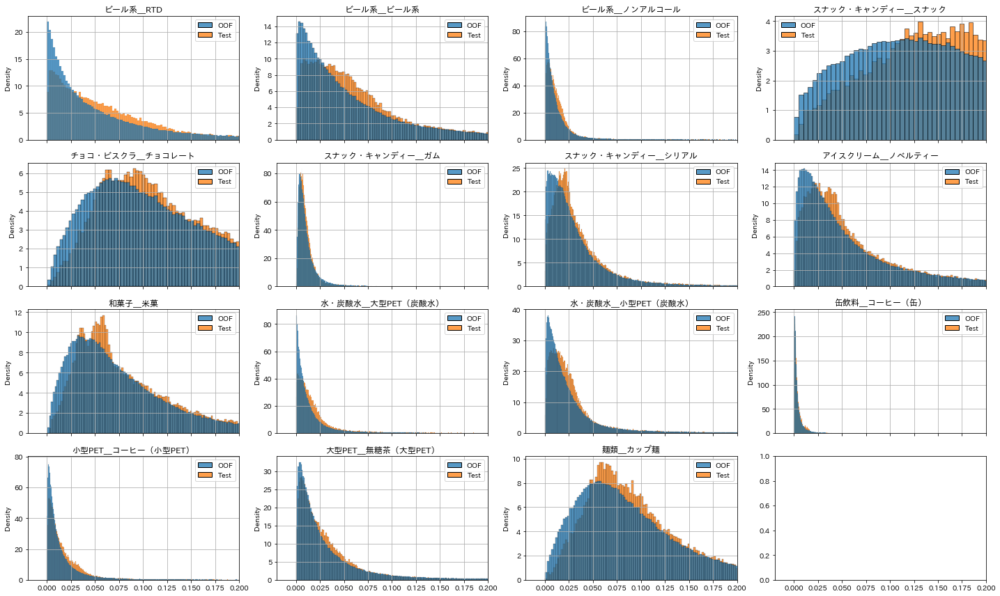

In [89]:
nfigs = len(oof_df.columns)
ncols = 4
nrows = - (- nfigs//ncols)

fig, axes = plt.subplots(figsize=(5*ncols, 3*nrows), ncols=ncols, nrows=nrows, sharex=True) # sharex: すべてのグラフ間でX軸を共有する
axes = np.ravel(axes)

for c, ax in zip(oof_df.columns, axes):
    sns.histplot(data=pd.DataFrame({
        "OOF": oof_df[c],
        "Test": pred_df[c]}),
        ax=ax, stat="density", common_norm=False) # common_norm は正規化をDF全体に行うか
    ax.set_title(id2cat[c])
    ax.grid()
    ax.set_xlim(-.02, .2) # X軸の範囲を-0.02〜0.2に固定
fig.tight_layout()

## 出力

In [101]:
pred_df[sorted(TARGET_IDS)].to_csv(os.path.join(OUTPUT_DIR,"tutorial2_submission.csv"), index=False)